In [298]:
import pandas as pd
from resizeimage import resizeimage
from PIL import Image
import webcolors
import os
import statistics as stats
import math
from colorthief import ColorThief
import matplotlib.pyplot as plt
%matplotlib inline

In [447]:
def get_pie(hex_colors):
    x = [1/len(hex_colors)]*len(hex_colors)
    plt.pie(x,colors=hex_colors, labels=hex_colors, labeldistance=.4, radius = 2, rotatelabels=True, textprops={"size":'xx-large','color':"w"});
    plt.show()

In [448]:
def get_avg_color(rgb_list):
    if isinstance(rgb_list[0], list):
        rgb_list = [item for sublist in rgb_list for item in sublist]
    r_list = []
    g_list = []
    b_list = []
    for color in rgb_list:
        r_list.append(color[0])
        g_list.append(color[1])
        b_list.append(color[2])
        avg_r = int(round(stats.mean(r_list),0))
        avg_g = int(round(stats.mean(g_list),0))
        avg_b = int(round(stats.mean(b_list),0))
        return((avg_r, avg_g, avg_b))

In [464]:
def read_imgs(folder, files):
    img_dict = {}
    for file in files:
        try:
            img_path = os.path.join(folder+ file)
            rgb_palette = ColorThief(img_path).get_palette(color_count=3, quality=10)
            img_dict[img_path] = (rgb_palette, get_avg_color(rgb_palette))
        except:
            pass
    return(img_dict)

In [560]:
def display_colors(img_dict):
    for img_path in img_dict.keys():
        display(Image.open(img_path, 'r'))
        rgb_palette = img_dict[img_path][0]
        if isinstance(rgb_palette, list):
            hex_palette =[webcolors.rgb_to_hex(rgb) for rgb in rgb_palette]
        else:
            hex_palette = webcolors.rgb_to_hex(rgb_palette)
        get_pie(hex_palette)
        

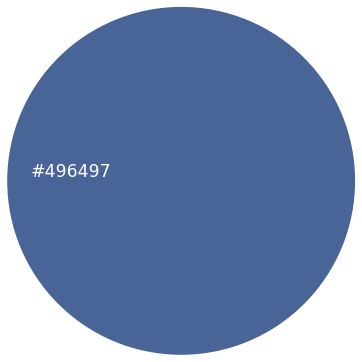

In [561]:
rgb_list = [[(73, 100, 151)], [(207, 229, 250), (156, 186, 236)]]
avg_rgb = get_avg_color(rgb_list)
avg_hex = webcolors.rgb_to_hex(avg_rgb)
get_pie([avg_hex])

In [562]:
stock_dict=[]
stock_files=[]
img_dict = {}

stock_files = os.listdir('images/')
stock_dict = read_imgs('images/',stock_files)

for path in stock_dict.keys():
    print(stock_dict[path][0])

[(66, 47, 32), (228, 184, 155), (165, 163, 165), (127, 138, 151)]
[(67, 61, 38), (209, 155, 155), (94, 177, 198), (64, 126, 164)]


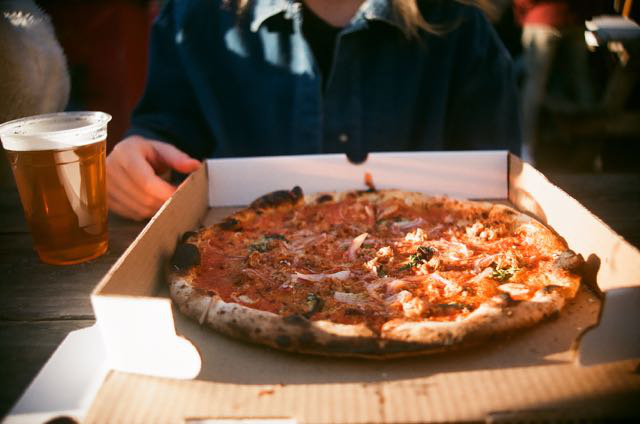

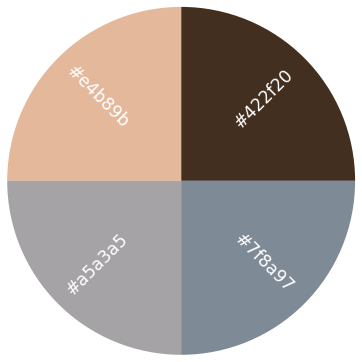

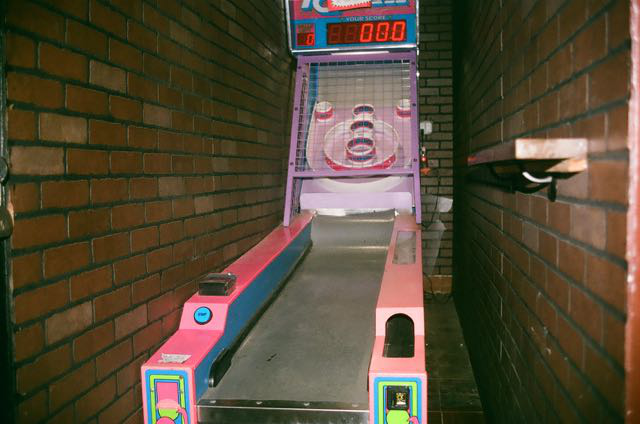

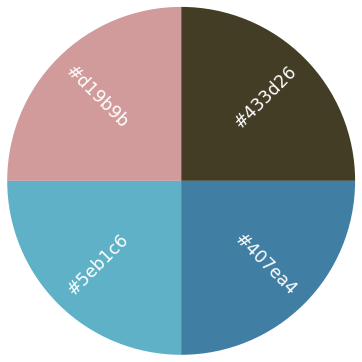

In [563]:
display_colors(stock_dict)

# Denim Popularity Data

In [490]:
img_dict ={}
img_files = os.listdir('denim/')
img_dict = read_imgs('denim/',img_files)

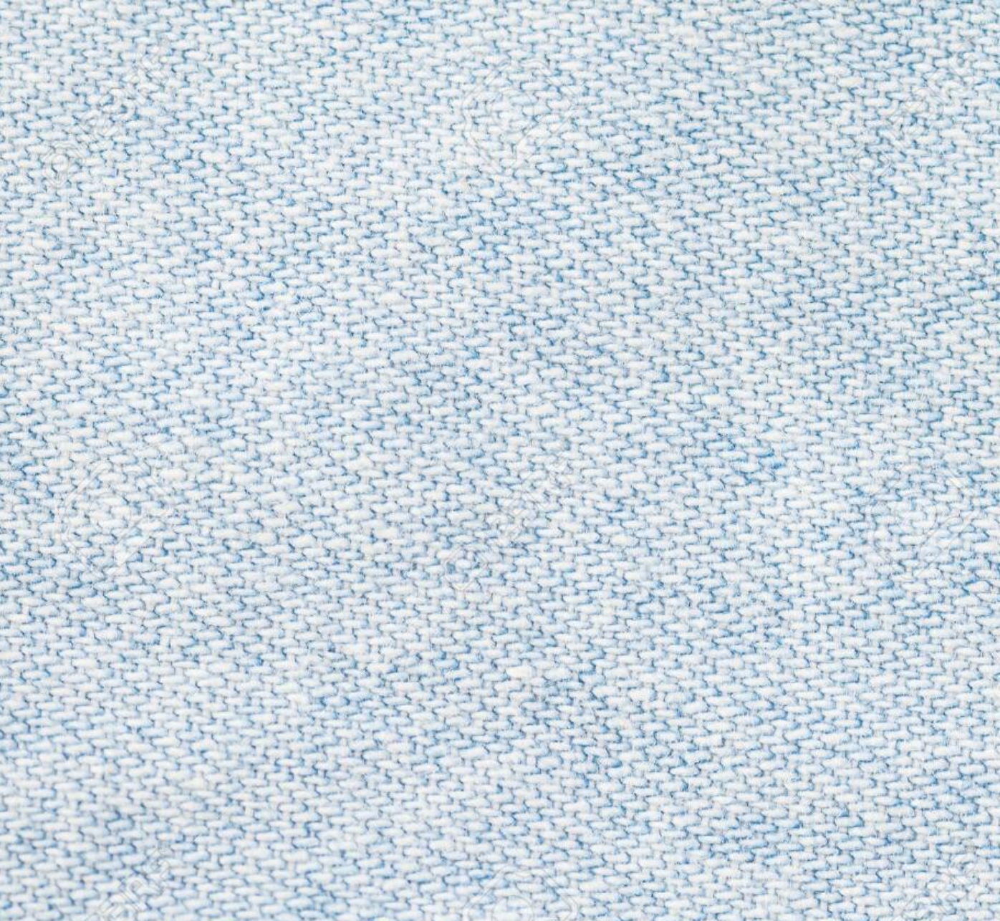

['#ccd9e1', '#718da0', '#87959b', '#848c9b']


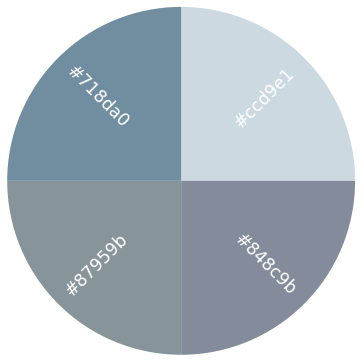

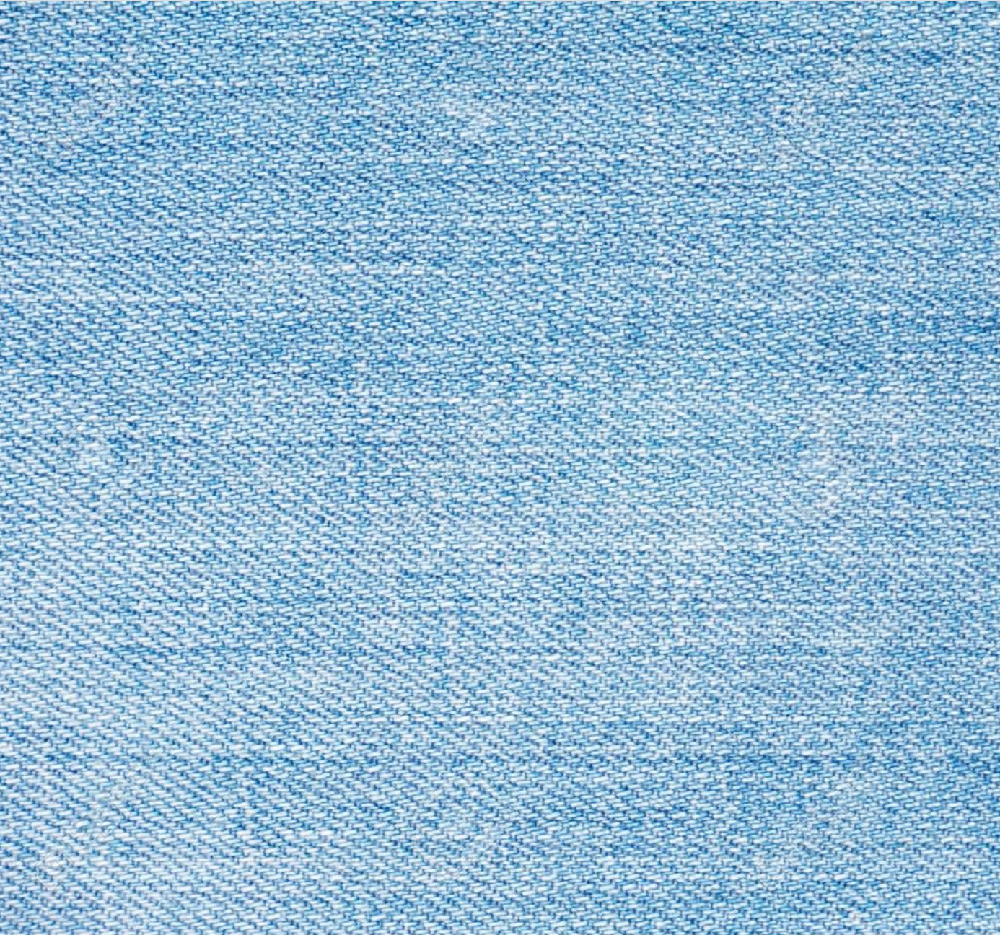

['#8fb7d3', '#d4edf9', '#386d95', '#4d6b8e']


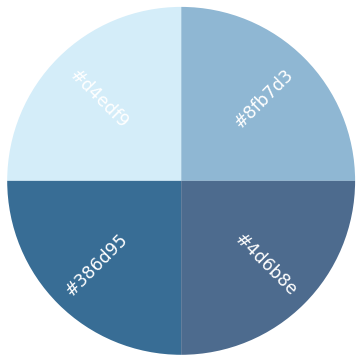

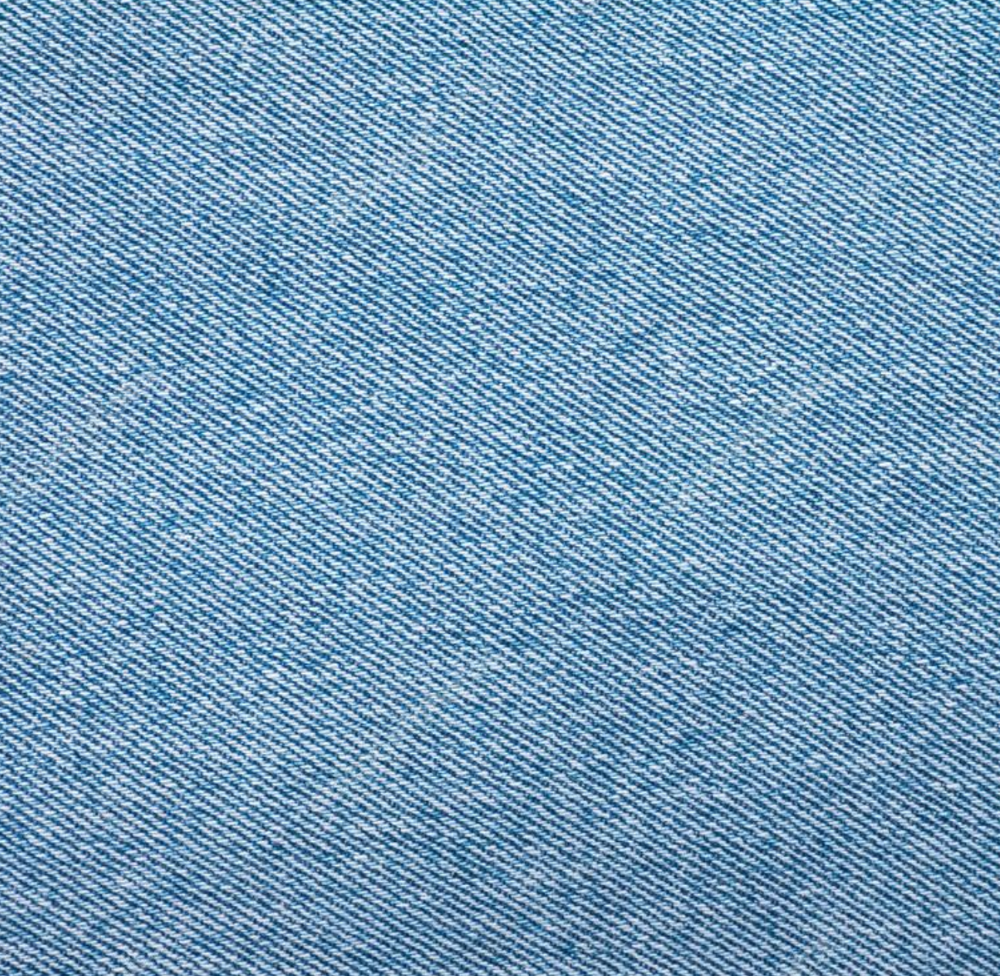

['#6d96b5', '#c9e6f4', '#1c4569', '#2a546b']


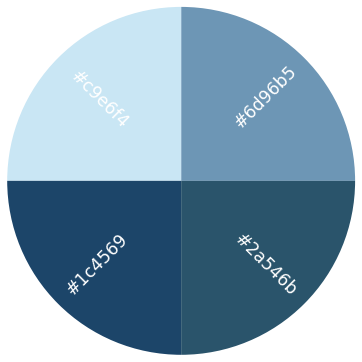

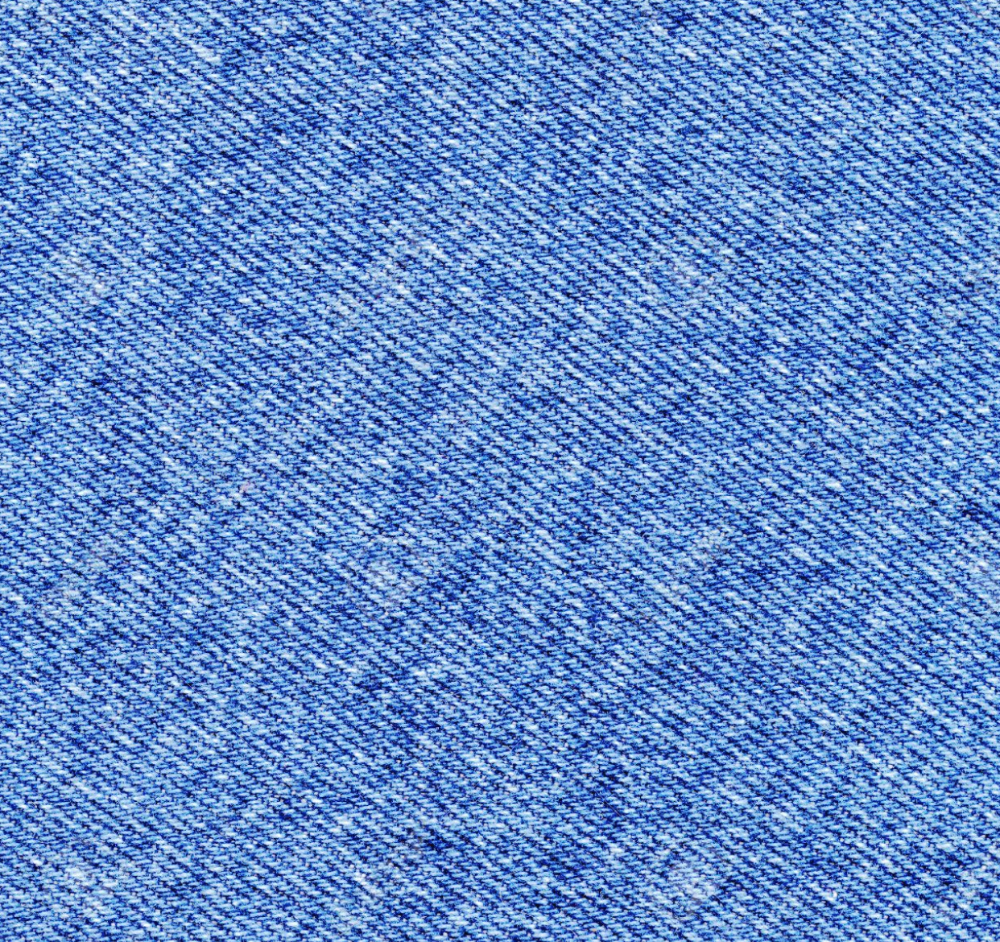

['#6894d1', '#c0ddf8', '#10297b', '#2e4669']


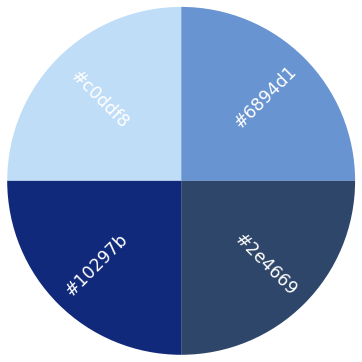

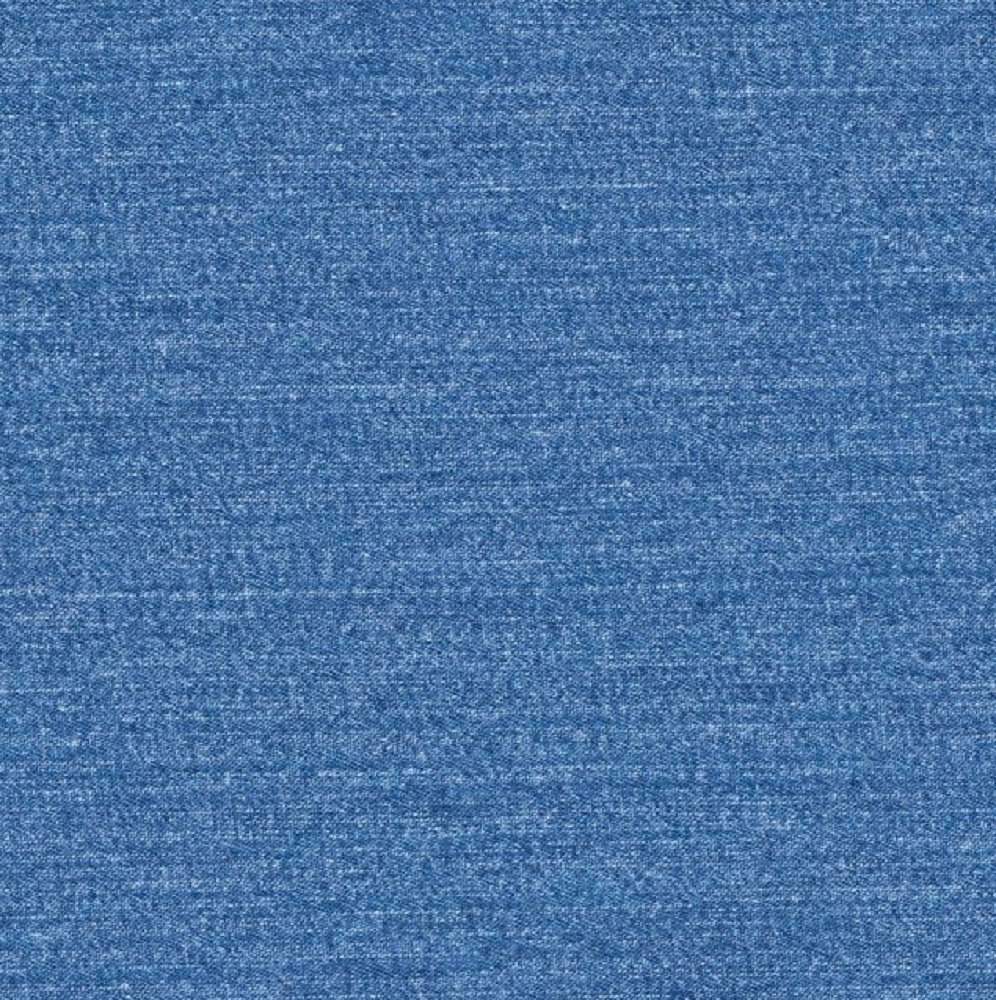

['#4671a2', '#8bb4df', '#78a4d5', '#7cb4dc']


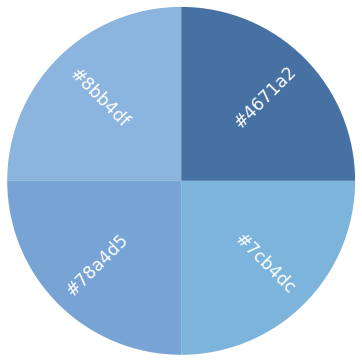

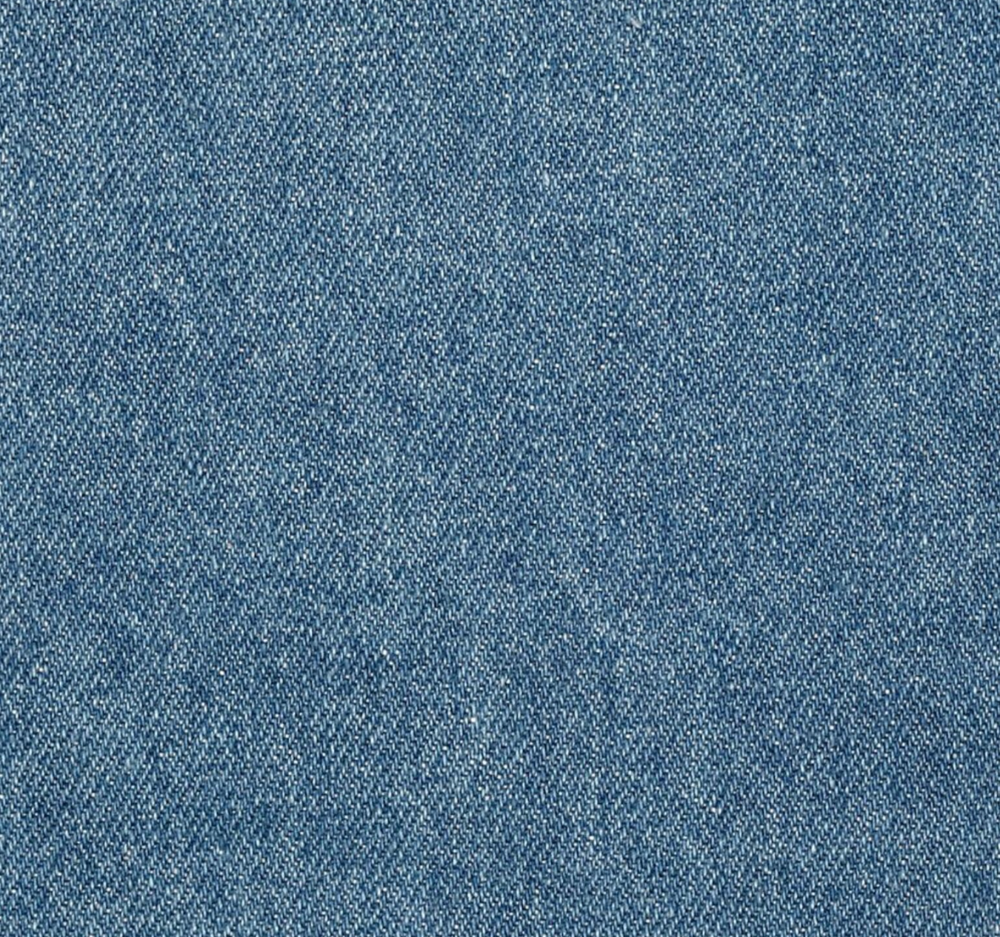

['#496880', '#adcbe0', '#8faec7', '#a4b3c7']


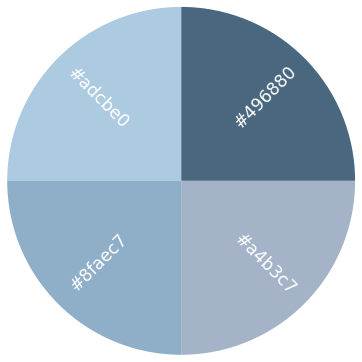

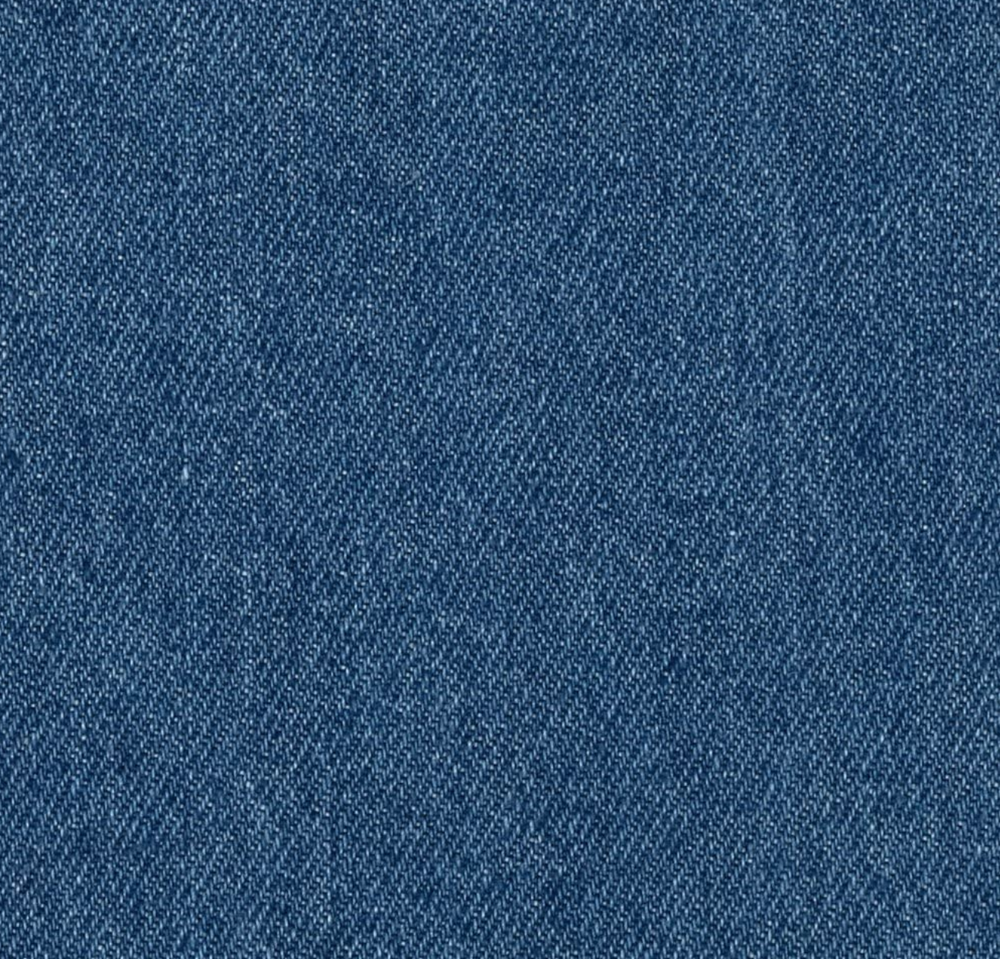

['#2c4c6d', '#8cadcd', '#7a9abc', '#849cb4']


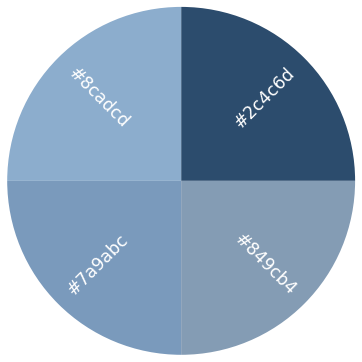

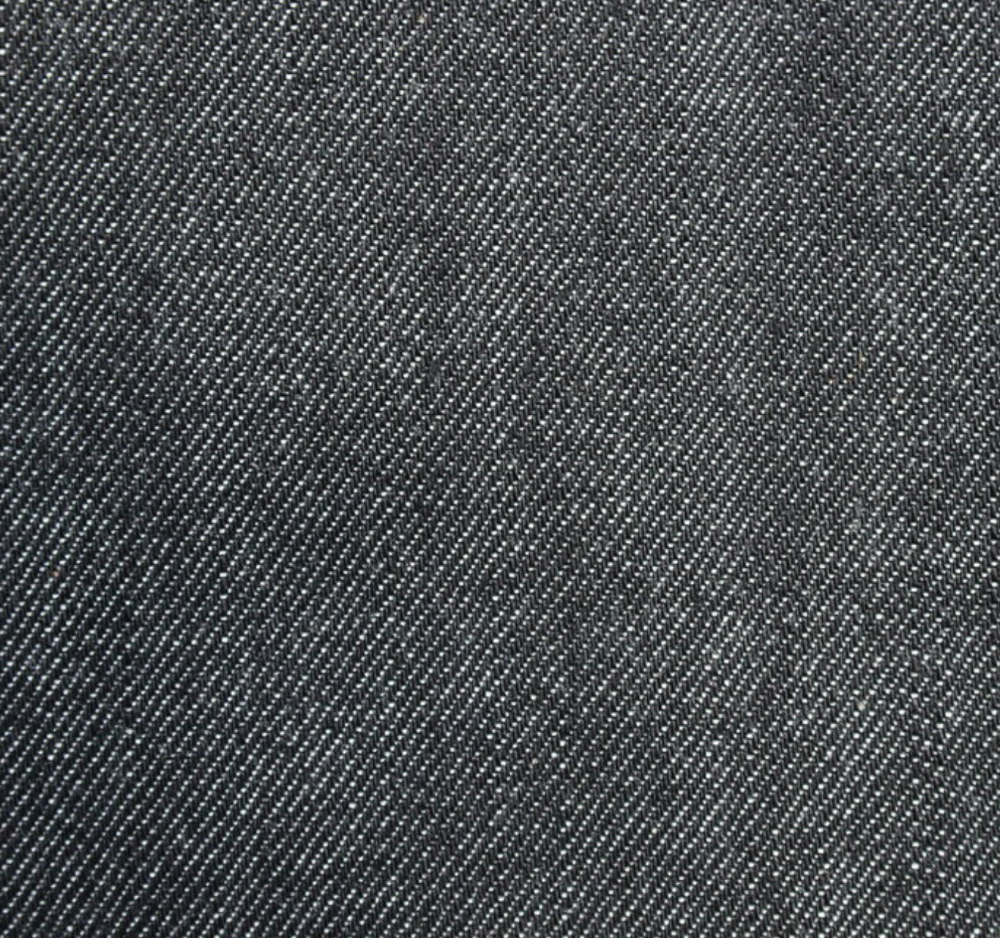

['#404446', '#c2c6c7', '#9ba4a4', '#9a9ba4']


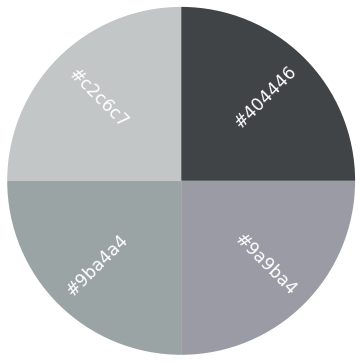

In [491]:
display_colors(img_dict)

In [493]:
df = pd.read_csv('Denim Survey.csv')
df.rename(columns={'What is your age?': 'age', 'What is your favorite shade of denim to WEAR?':'shade', 'What state do you currently live in? (where you usually live/work/pay rent etc)':'state'}, inplace=True)



In [517]:
conditions =[
    df['shade'] == 'Option 1',
    df['shade'] == 'Option 2',
    df['shade'] == 'Option 3',
    df['shade'] == 'Option 4',
    df['shade'] == 'Option 5',
    df['shade'] == 'Option 6',
    df['shade'] == 'Option 7',
    df['shade'] == 'Option 8'
]
choices =[
    img_dict['denim/option1.png'][1][0],
    img_dict['denim/option2.png'][1][0],
    img_dict['denim/option3.png'][1][0],
    img_dict['denim/option4.png'][1][0],
    img_dict['denim/option5.png'][1][0],
    img_dict['denim/option6.png'][1][0],
    img_dict['denim/option7.png'][1][0],
    img_dict['denim/option8.png'][1][0]
]

df['r'] = np.select(conditions, choices, default='na')
df.r = df.r.astype(int)

In [518]:
conditions =[
    df['shade'] == 'Option 1',
    df['shade'] == 'Option 2',
    df['shade'] == 'Option 3',
    df['shade'] == 'Option 4',
    df['shade'] == 'Option 5',
    df['shade'] == 'Option 6',
    df['shade'] == 'Option 7',
    df['shade'] == 'Option 8'
]
choices =[
    img_dict['denim/option1.png'][1][1],
    img_dict['denim/option2.png'][1][1],
    img_dict['denim/option3.png'][1][1],
    img_dict['denim/option4.png'][1][1],
    img_dict['denim/option5.png'][1][1],
    img_dict['denim/option6.png'][1][1],
    img_dict['denim/option7.png'][1][1],
    img_dict['denim/option8.png'][1][1]
]

df['g'] = np.select(conditions, choices, default='na')
df.g = df.g.astype(int)

In [519]:
conditions =[
    df['shade'] == 'Option 1',
    df['shade'] == 'Option 2',
    df['shade'] == 'Option 3',
    df['shade'] == 'Option 4',
    df['shade'] == 'Option 5',
    df['shade'] == 'Option 6',
    df['shade'] == 'Option 7',
    df['shade'] == 'Option 8'
]
choices =[
    img_dict['denim/option1.png'][1][2],
    img_dict['denim/option2.png'][1][2],
    img_dict['denim/option3.png'][1][2],
    img_dict['denim/option4.png'][1][2],
    img_dict['denim/option5.png'][1][2],
    img_dict['denim/option6.png'][1][2],
    img_dict['denim/option7.png'][1][2],
    img_dict['denim/option8.png'][1][2]
]

df['b'] = np.select(conditions, choices, default='na')
df.b = df.b.astype(int)
df

,Timestamp,age,shade,state,r,g,b
0,2020/10/24 2:52:17 PM AST,18-22,Option 7,Michigan,44,76,109
1,2020/10/24 2:52:18 PM AST,23-29,Option 6,Michigan,73,104,128
2,2020/10/24 2:58:21 PM AST,23-29,Option 4,Michigan,104,148,209
3,2020/10/24 3:01:32 PM AST,23-29,Option 7,Michigan,44,76,109
4,2020/10/24 3:04:22 PM AST,18-22,Option 8,Michigan,64,68,70
...,...,...,...,...,...,...,...
200,2020/10/25 11:00:42 AM AST,18-22,Option 7,Outside of United States,44,76,109
201,2020/10/25 11:02:23 AM AST,23-29,Option 6,Michigan,73,104,128
202,2020/10/25 11:04:40 AM AST,18-22,Option 2,Michigan,143,183,211
203,2020/10/25 11:16:13 AM AST,50-59,Option 5,New Jersey,70,113,162


In [564]:
df = df.groupby(['state'])['r', 'g', 'b'].mean()
df.r = df.r.astype(int)
df.g = df.g.astype(int)
df.b = df.b.astype(int)

/Users/Khyatee/anaconda3/envs/learn-env/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  """Entry point for launching an IPython kernel.


In [565]:
df.head()

,r,g,b
state,,,
California,118,144,163
Colorado,44,76,109
Connecticut,64,68,70
Florida,58,90,118
Georgia,84,108,139


In [570]:
rgb_state = list(zip(df.r, df.g, df.b))
df['hex'] = [webcolors.rgb_to_hex(rgb) for rgb in rgb_state]
df.head()

,r,g,b,hex
state,,,,
California,118,144,163,#7690a3
Colorado,44,76,109,#2c4c6d
Connecticut,64,68,70,#404446
Florida,58,90,118,#3a5a76
Georgia,84,108,139,#546c8b


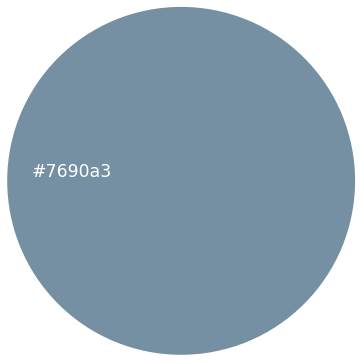

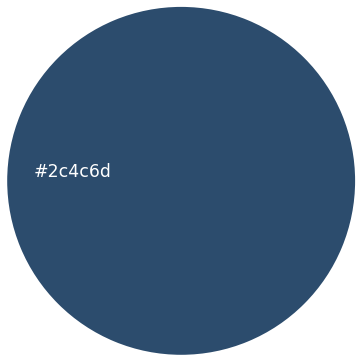

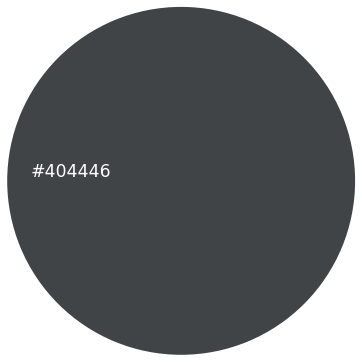

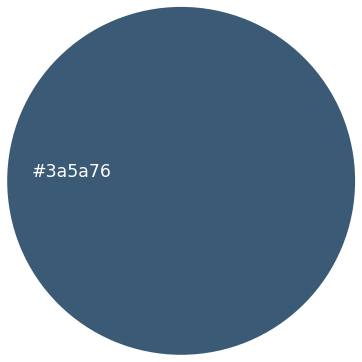

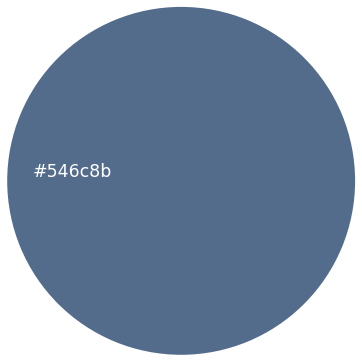

...

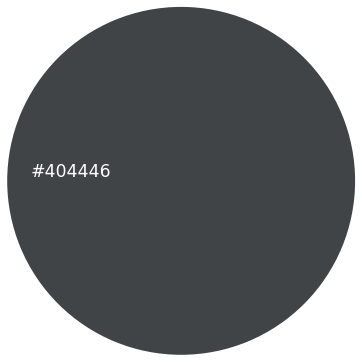

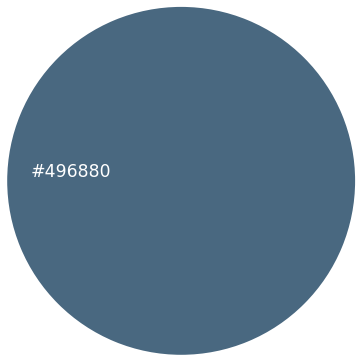

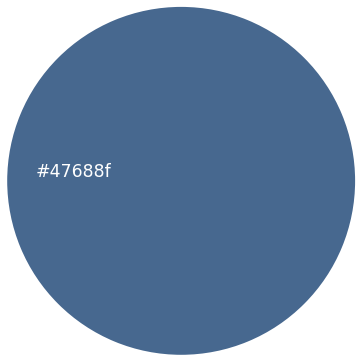

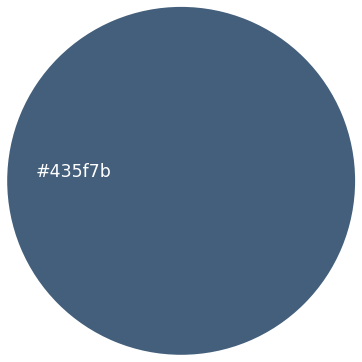

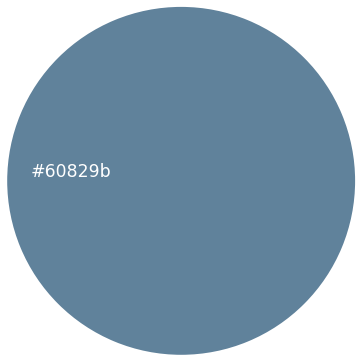

In [572]:
for h in df.hex[:15]:
    get_pie([h])